### Experiment :
### Objectives

1. Train LSTM model
2. Train GRU model
3. Train Bidirectional model, with attention mechanism
4. Error analysis on each variant
5. Train random and word2vec embedding

### Observations

1. 
2. 
3. 

### Solutions and further investigation

1. 
2. 
3. 

### Load Modeules and datasets

In [1]:
import numpy as np
import random as rn
np.random.seed(0)
rn.seed(0)
import pandas as pd
import matplotlib.pyplot as plt
pd.set_option('display.max_colwidth', 1000)
# import helper function script
import sys
sys.path.insert(1,'G:\\Github\\Sinhala-Hate-Speech-Detection')
import utills
import TextClassifier


Instructions for updating:
non-resource variables are not supported in the long term


In [2]:
#Random embedding
TC = TextClassifier.TextClassifier(EMBEDDING=None)

Load data

X train (4526,) Y train (4526,) X test (1940,) Y test (1940,)
dictionary size:  17577


#### Random emb

In [39]:
def get_model(TC,model_type):
    from tensorflow.python.keras.models import Sequential
    from tensorflow.python.keras.optimizer_v2.adam import Adam
    from tensorflow.python.keras.layers import Dense,Input,SpatialDropout1D,Dropout,Flatten, SimpleRNN,LSTM,RNN,GRU,Bidirectional
    from tensorflow.python.keras.layers.embeddings import Embedding
    print("Build ML model")
    model = Sequential()
    if(TC.EMBEDDING == None):
        model.add(Embedding(output_dim=TC.EMBEDDING_SIZE, 
                        input_dim=TC.LEN_VOCAB, 
                        input_length=TC.MAX_SEQ_LEN,
                       # weights=[TC.emb_matrix], # Additionally we give the Wi
                        trainable=TC.trainable))

    else:
        model.add(Embedding(output_dim=TC.EMBEDDING_SIZE, 
                        input_dim=TC.LEN_VOCAB, 
                        input_length=TC.MAX_SEQ_LEN,
                        weights=[TC.emb_matrix], # Additionally we give the Wi
                        trainable=TC.trainable)) # Don't train the embeddings - just use GloVe embeddings
    # We can start with pre-trained embeddings and then fine-tune them using our data by setting trainable to True
    if(model_type=="RNN"):
        model.add(SimpleRNN(128, activation='relu',dropout=0.2, recurrent_dropout=0.3))
    elif(model_type == "LSTM"):
        model.add(LSTM(128, activation='relu',dropout=0.2, recurrent_dropout=0.2))
    elif(model_type == "GRU"):
        model.add(GRU(128, activation='relu',dropout=0.2, recurrent_dropout=0.3))
    elif(model_type == "BiLSTM"):
        model.add(Bidirectional(LSTM(128, activation='relu',dropout=0.2, recurrent_dropout=0.3)))
    elif(model_type == "Bigru2"):
        print("new")
        model.add(Bidirectional(GRU(64, activation='relu',dropout=0.2, recurrent_dropout=0.3)))
    elif(model_type == "BiGRU"):
        print("bigru")
        model.add(Bidirectional(GRU(128, activation='relu',dropout=0.2, recurrent_dropout=0.3)))
    model.add(Dropout(0.2))
    model.add(Dense(32, activation='relu'))
    model.add(Dropout(0.2))
    model.add(Dense(1,activation='sigmoid'))
    optimizer_adam = Adam(learning_rate=TC.lr)
    model.compile(loss='binary_crossentropy',
                optimizer=optimizer_adam,
                metrics=['acc'])
    print(model.summary())
    TC.model = model
    return model

In [44]:
def build_model(TC):
    from tensorflow.python.keras.models import Sequential
    from tensorflow.python.keras.optimizer_v2.adam import Adam
    from tensorflow.python.keras.layers import Dense,Input,SpatialDropout1D,Dropout,Flatten, SimpleRNN,LSTM,RNN,GRU,Bidirectional,GlobalMaxPool1D,Conv1D
    from tensorflow.python.keras.layers.embeddings import Embedding
    model = Sequential()
    if(TC.EMBEDDING == None):
        model.add(Embedding(output_dim=TC.EMBEDDING_SIZE, 
                        input_dim=TC.LEN_VOCAB, 
                        input_length=TC.MAX_SEQ_LEN,
                       # weights=[TC.emb_matrix], # Additionally we give the Wi
                        trainable=TC.trainable))

    else:
        model.add(Embedding(output_dim=TC.EMBEDDING_SIZE, 
                        input_dim=TC.LEN_VOCAB, 
                        input_length=TC.MAX_SEQ_LEN,
                        weights=[TC.emb_matrix], # Additionally we give the Wi
                        trainable=TC.trainable)) # Don't train the embeddings - just use GloVe embeddings
    # We can start with pre-trained embeddings and then fine-tune them using our data by setting trainable to True
    model.add(SpatialDropout1D(0.3))
    model.add(Bidirectional(GRU(128, dropout=0.2, recurrent_dropout=0.2,return_sequences=True)))
    model.add(Bidirectional(GRU(128, dropout=0.2, recurrent_dropout=0.2,return_sequences=True)))
    model.add(Conv1D(64, 4))
    model.add(GlobalMaxPool1D())
    model.add(Dense(64, activation='relu'))
    model.add(Dense(1,activation='sigmoid'))
    optimizer_adam = Adam(learning_rate=TC.lr)
    model.compile(loss='binary_crossentropy',
                optimizer=optimizer_adam,
                metrics=['acc'])
    print(model.summary())
    TC.model = model
    return model

In [46]:
def build_model2(TC):
    from tensorflow.python.keras.models import Sequential
    from tensorflow.python.keras.optimizer_v2.adam import Adam
    from tensorflow.python.keras.layers import Dense,Input,SpatialDropout1D,Dropout,Flatten, SimpleRNN,LSTM,RNN,GRU,Bidirectional,GlobalMaxPool1D,Conv1D
    from tensorflow.python.keras.layers.embeddings import Embedding
    model = Sequential()
    if(TC.EMBEDDING == None):
        model.add(Embedding(output_dim=TC.EMBEDDING_SIZE, 
                        input_dim=TC.LEN_VOCAB, 
                        input_length=TC.MAX_SEQ_LEN,
                       # weights=[TC.emb_matrix], # Additionally we give the Wi
                        trainable=TC.trainable))

    else:
        model.add(Embedding(output_dim=TC.EMBEDDING_SIZE, 
                        input_dim=TC.LEN_VOCAB, 
                        input_length=TC.MAX_SEQ_LEN,
                        weights=[TC.emb_matrix], # Additionally we give the Wi
                        trainable=TC.trainable)) # Don't train the embeddings - just use GloVe embeddings
    # We can start with pre-trained embeddings and then fine-tune them using our data by setting trainable to True
    model.add(SpatialDropout1D(0.3))
    model.add(Bidirectional(LSTM(128, dropout=0.2, recurrent_dropout=0.2,return_sequences=True)))
    model.add(Bidirectional(LSTM(128, dropout=0.2, recurrent_dropout=0.2,return_sequences=True)))
    model.add(Conv1D(64, 4))
    model.add(GlobalMaxPool1D())
    model.add(Dense(64, activation='relu'))
    model.add(Dense(1,activation='sigmoid'))
    optimizer_adam = Adam(learning_rate=TC.lr)
    model.compile(loss='binary_crossentropy',
                optimizer=optimizer_adam,
                metrics=['acc'])
    print(model.summary())
    TC.model = model
    return model

In [11]:
def predict_proba(arr,TC=TC):
    import numpy as np
    from tensorflow.python.keras.preprocessing import sequence
    pred=TC.model.predict(sequence.pad_sequences(TC.token.texts_to_sequences(arr),maxlen=TC.MAX_SEQ_LEN))
    returnable=[]
    for i in pred:
        temp=i[0]
        returnable.append(np.array([1-temp,temp]))
    return np.array(returnable)


def error_analysis(TC,model,Y_pred):
    import numpy as np
    from IPython.display import display
    import matplotlib.pyplot as plt
    import eli5
    from eli5.lime import TextExplainer
    import shap
    from lime.lime_text import LimeTextExplainer
    import tensorflow.compat.v1 as tf
    tf.disable_v2_behavior()
    from tensorflow.python.keras.preprocessing import sequence

    import tensorflow.keras.backend as K
    #token = Tokenizer(num_words=self.LEN_VOCAB)
    #token.fit_on_texts(self.X_tr)
    lime_explainer= LimeTextExplainer(class_names=[0,1])

    te = TextExplainer(random_state=0)
    distrib_samples = TC.X_train[:100]
    explainer = shap.DeepExplainer(model, distrib_samples)
    # explain the first 25 predictions
    # explaining each prediction requires 2 * background dataset size runs
    num_explanations = 25 #len(TC_F.X_test)
    shap_values = explainer.shap_values(TC.X_test[:num_explanations])
    shap.initjs()
    num2word = {}
    arr_index=TC.X_te.index
    for w in TC.word_index.keys():
        num2word[TC.word_index[w]] = w
    x_test_words = np.stack([np.array(list(map(lambda x: num2word.get(x, "NONE"), TC.X_test[i]))) for i in range(num_explanations)])
    i=0
    
    for s in TC.X_te:
        if(i==21):
            break
        if(TC.Y_test[arr_index[i]] != Y_pred[i]):
            print(s)
            print("Predicted Label : ",TC.result_map(Y_pred[i])," | Turth Label : ",TC.result_map(TC.Y_test[arr_index[i]]))
            te.fit(TC.X_te[arr_index[i]],predict_proba)
            shap.force_plot(explainer.expected_value[0], shap_values[0][i], x_test_words[i],matplotlib=True)
            display(te.show_prediction(target_names=[0,1]))
            display(lime_explainer.explain_instance(TC.X_te[arr_index[i]],predict_proba).show_in_notebook(text=True))
        i+=1
        print()

##### RNN

Build ML model
Instructions for updating:
Call initializer instance with the dtype argument instead of passing it to the constructor
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
embedding (Embedding)        (None, 100, 300)          6000000   
_________________________________________________________________
simple_rnn (SimpleRNN)       (None, 128)               54912     
_________________________________________________________________
dropout (Dropout)            (None, 128)               0         
_________________________________________________________________
dense (Dense)                (None, 64)                8256      
_________________________________________________________________
dropout_1 (Dropout)          (None, 64)                0         
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 

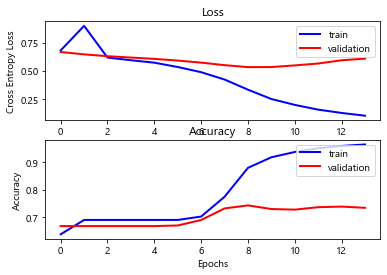

========= Eperiment -  RNN rand emb lr-0.0001  =========


Info (NVML): NVML Shared Library Not Found. GPU usage metrics may not be reported. For more information, see https://docs-legacy.neptune.ai/logging-and-managing-experiment-results/logging-experiment-data.html#hardware-consumption 


https://app.neptune.ai/codekcg23/Research-Experiments/e/RES-486
              precision    recall  f1-score   support

           0       0.78      0.86      0.82      1336
           1       0.60      0.45      0.51       604

    accuracy                           0.73      1940
   macro avg       0.69      0.66      0.67      1940
weighted avg       0.72      0.73      0.72      1940

Predicted     0    1
Actual              
0          1152  184
1           331  273


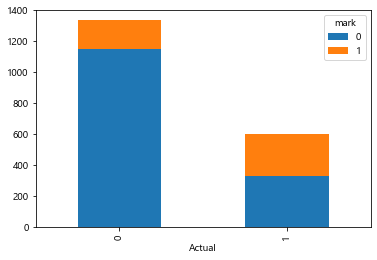

එන්න එන්න දැන් පරක්කු නෑ මුළ ටික හෙට එකෙන් අහමු ඊට පස්සේ ආයම
Predicted Label :  Not Hate  | Turth Label :  Not Hate

ඕකගේ ලාච්චුවේ දාපල්ලා නරුමයා
Predicted Label :  Hate  | Turth Label :  Hate

කන්න බොන්න දීලා කරට අත දාගෙන පිටිපස්සෙන් පිහියෙන් අනින සිස්ටම් එක තමයි පර්සි ලග තිබ්බෙ අන්තිමට පර්සි ලග හිටියා සුමනයා පර්සිටත් දුන්නෙ එවැනිම පාරක් තමයි හතර ගාතෙන් ඇදගෙන වැටෙන්න
Predicted Label :  Not Hate  | Turth Label :  Not Hate

කෝටි න් ගියත් ත්‍රී වීල් එකෙන් ගියත් යන්නෙ එකම පාරෙ නෙ බං කවදාහරි දවසක ඕකත් දිරලා වල පල්ලට යනවා කෝටි කින් කරන්න තව වැඩ කොච්චර නම් තියේද
Predicted Label :  Not Hate  | Turth Label :  Hate

ඒකි හිතන් ඇත්තේ අපිට පුපේ ඉත්තෑවෝ දුවනව කියලද දන්නෑ ෆේක් වලින් හරි ගිහින් එව්ව බලන්න
Predicted Label :  Not Hate  | Turth Label :  Hate

මේ තට්ටයව මුණ ගැහිලම විස්තරේ අහගනින් සියනෑවේ සිංහයා කියලා ඡන්දෙට ඉල්ලුවෙ සිංහයෙක් තියා හිවලෙක්වත් වෙන්න බෑ කියලා දැන් ඔප්පු වෙලා තියෙන්නෙ
Predicted Label :  Not Hate  | Turth Label :  Hate

සිවුරක් දමාගැනීම දමිත් අසංක පුක පෙන්වීම පිදුරංගල වීරයෝ සෙට

In [4]:
TC.EPOCHS =50
TC.BATCH_SIZE =16
TC.lr = 0.0001
TC.trainable = True
TC.tag = "RNN rand emb lr-0.0001"

rnn_model = TC.get_model("RNN")
rnn_model, hist = TC.train_model(rnn_model)
Y_pred = TC.model_evaluate(rnn_model,hist)
TC.save_predictions(Y_pred,TC.tag)

In [ ]:
utills.error_analysis(TC,rnn_model,Y_pred)

##### GRU

Build ML model
Model: "sequential_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
embedding_3 (Embedding)      (None, 100, 300)          6000000   
_________________________________________________________________
gru (GRU)                    (None, 128)               164736    
_________________________________________________________________
dropout_6 (Dropout)          (None, 128)               0         
_________________________________________________________________
dense_6 (Dense)              (None, 64)                8256      
_________________________________________________________________
dropout_7 (Dropout)          (None, 64)                0         
_________________________________________________________________
dense_7 (Dense)              (None, 1)                 65        
Total params: 6,173,057
Trainable params: 6,173,057
Non-trainable params: 0
_____________________________

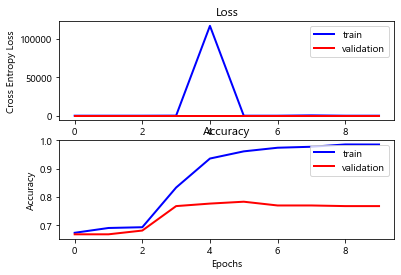

========= Eperiment -  GRU rand emb lr-0.0001  =========
https://app.neptune.ai/codekcg23/Research-Experiments/e/RES-489


Unexpected error in ping thread.
Traceback (most recent call last):
  File "C:\Users\Kavishka\anaconda3\lib\site-packages\urllib3\connectionpool.py", line 672, in urlopen
    chunked=chunked,
  File "C:\Users\Kavishka\anaconda3\lib\site-packages\urllib3\connectionpool.py", line 421, in _make_request
    six.raise_from(e, None)
  File "<string>", line 3, in raise_from
  File "C:\Users\Kavishka\anaconda3\lib\site-packages\urllib3\connectionpool.py", line 416, in _make_request
    httplib_response = conn.getresponse()
  File "C:\Users\Kavishka\anaconda3\lib\http\client.py", line 1344, in getresponse
    response.begin()
  File "C:\Users\Kavishka\anaconda3\lib\http\client.py", line 306, in begin
    version, status, reason = self._read_status()
  File "C:\Users\Kavishka\anaconda3\lib\http\client.py", line 267, in _read_status
    line = str(self.fp.readline(_MAXLINE + 1), "iso-8859-1")
  File "C:\Users\Kavishka\anaconda3\lib\socket.py", line 589, in readinto
    return self._sock.recv_into

              precision    recall  f1-score   support

           0       0.83      0.91      0.87      1336
           1       0.75      0.59      0.66       604

    accuracy                           0.81      1940
   macro avg       0.79      0.75      0.76      1940
weighted avg       0.80      0.81      0.80      1940

Predicted     0    1
Actual              
0          1214  122
1           247  357


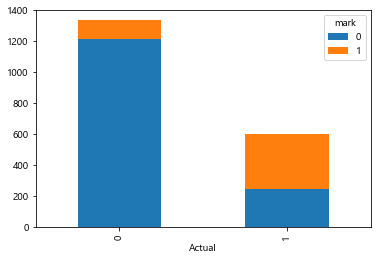

එන්න එන්න දැන් පරක්කු නෑ මුළ ටික හෙට එකෙන් අහමු ඊට පස්සේ ආයම
Predicted Label :  Not Hate  | Turth Label :  Not Hate

ඕකගේ ලාච්චුවේ දාපල්ලා නරුමයා
Predicted Label :  Hate  | Turth Label :  Hate

කන්න බොන්න දීලා කරට අත දාගෙන පිටිපස්සෙන් පිහියෙන් අනින සිස්ටම් එක තමයි පර්සි ලග තිබ්බෙ අන්තිමට පර්සි ලග හිටියා සුමනයා පර්සිටත් දුන්නෙ එවැනිම පාරක් තමයි හතර ගාතෙන් ඇදගෙන වැටෙන්න
Predicted Label :  Hate  | Turth Label :  Not Hate

කෝටි න් ගියත් ත්‍රී වීල් එකෙන් ගියත් යන්නෙ එකම පාරෙ නෙ බං කවදාහරි දවසක ඕකත් දිරලා වල පල්ලට යනවා කෝටි කින් කරන්න තව වැඩ කොච්චර නම් තියේද
Predicted Label :  Not Hate  | Turth Label :  Hate

ඒකි හිතන් ඇත්තේ අපිට පුපේ ඉත්තෑවෝ දුවනව කියලද දන්නෑ ෆේක් වලින් හරි ගිහින් එව්ව බලන්න
Predicted Label :  Hate  | Turth Label :  Hate

මේ තට්ටයව මුණ ගැහිලම විස්තරේ අහගනින් සියනෑවේ සිංහයා කියලා ඡන්දෙට ඉල්ලුවෙ සිංහයෙක් තියා හිවලෙක්වත් වෙන්න බෑ කියලා දැන් ඔප්පු වෙලා තියෙන්නෙ
Predicted Label :  Not Hate  | Turth Label :  Hate

සිවුරක් දමාගැනීම දමිත් අසංක පුක පෙන්වීම පිදුරංගල වීරයෝ සෙට් එකම එක

In [9]:
TC.EPOCHS =50
TC.BATCH_SIZE =16
TC.lr = 0.0001
TC.trainable = True
TC.tag = "GRU rand emb lr-0.0001"

gru_model = TC.get_model("GRU")
gru_model, hist = TC.train_model(gru_model)
Y_pred = TC.model_evaluate(gru_model,hist)
TC.save_predictions(Y_pred,TC.tag)



කන්න බොන්න දීලා කරට අත දාගෙන පිටිපස්සෙන් පිහියෙන් අනින සිස්ටම් එක තමයි පර්සි ලග තිබ්බෙ අන්තිමට පර්සි ලග හිටියා සුමනයා පර්සිටත් දුන්නෙ එවැනිම පාරක් තමයි හතර ගාතෙන් ඇදගෙන වැටෙන්න
Predicted Label :  Hate  | Turth Label :  Not Hate


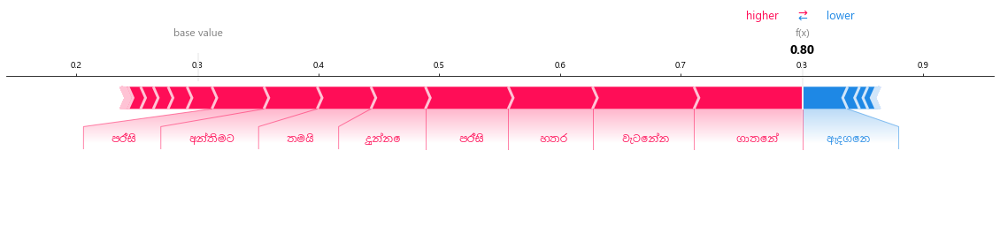

None


කෝටි න් ගියත් ත්‍රී වීල් එකෙන් ගියත් යන්නෙ එකම පාරෙ නෙ බං කවදාහරි දවසක ඕකත් දිරලා වල පල්ලට යනවා කෝටි කින් කරන්න තව වැඩ කොච්චර නම් තියේද
Predicted Label :  Not Hate  | Turth Label :  Hate


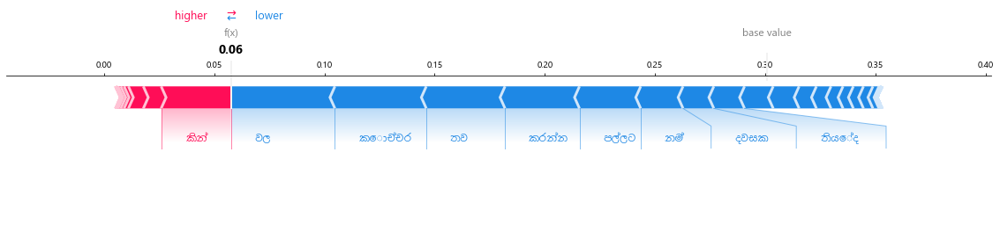

None



මේ තට්ටයව මුණ ගැහිලම විස්තරේ අහගනින් සියනෑවේ සිංහයා කියලා ඡන්දෙට ඉල්ලුවෙ සිංහයෙක් තියා හිවලෙක්වත් වෙන්න බෑ කියලා දැන් ඔප්පු වෙලා තියෙන්නෙ
Predicted Label :  Not Hate  | Turth Label :  Hate


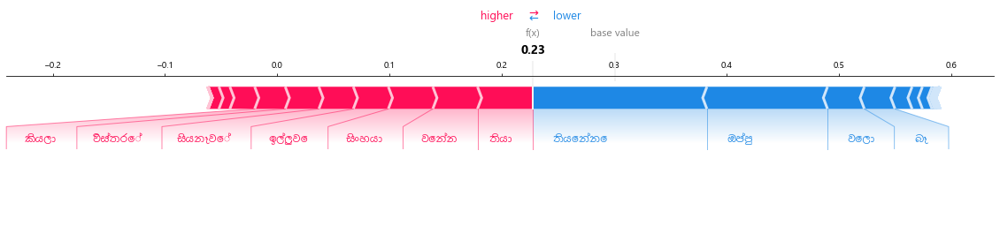

None


සිවුරක් දමාගැනීම දමිත් අසංක පුක පෙන්වීම පිදුරංගල වීරයෝ සෙට් එකම එකම සෙල් එකට සෙට් උනොත් සිංදු කිය කිය පුක පෙන්නතැකි
Predicted Label :  Hate  | Turth Label :  Not Hate


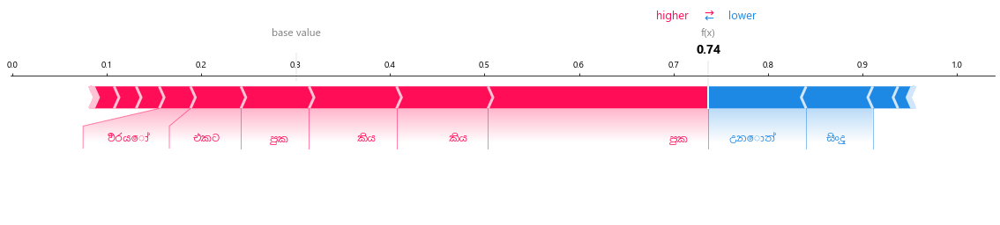

None




අනේ පලයන් බොල බොරු නොකියා නොදන්න මිනිහෙක් ඇවිල්ලා ප්‍රශ්න අහනකොට මේ වගේ උත්තර දෙනවද උන් මේවා කියපන් කොන්ඩෙ බැදපු චීනෙක්ට
Predicted Label :  Not Hate  | Turth Label :  Hate


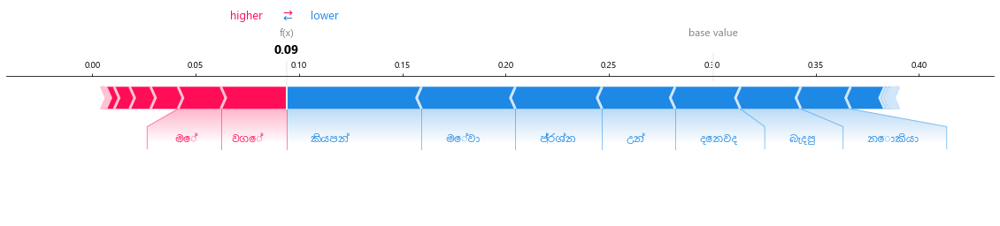

None





ලොරි ඩ්‍රයිවර්ලා ඔක්කොම ඔහොම මෝඩ වැඩ තමය් කරන්නේ ඒගොල්ලන් ඉගනගැන නැති හින්ද නේ ඩ්‍රයිවර් කෙනෙක් වෙන්නේ
Predicted Label :  Not Hate  | Turth Label :  Hate


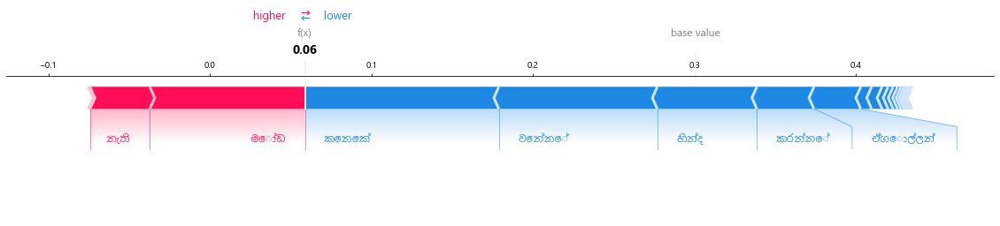

None





මේවට හිනා වෙන්න ඕනෙ යකෝ අධෝ මුඛයෙන් මේ වගේ නාකියෙක් බැදගෙන මදිවට මේකි කියන පුරසාරම් ඇහුවම අපි කුඩු ගහලද නැත්තං මේකි කුඩු ගහලද කියලා හිතෙනවා
Predicted Label :  Not Hate  | Turth Label :  Hate


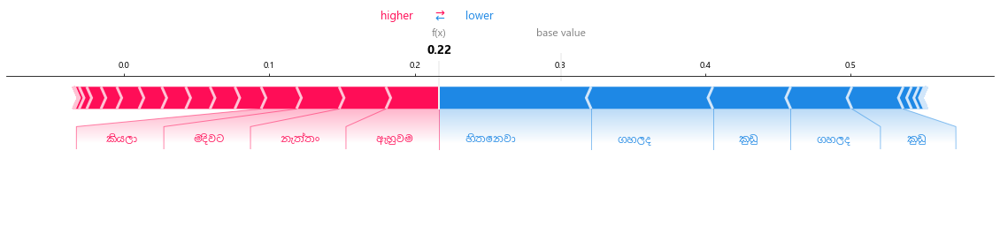

None




ගොම්මන් අපලෙ උඹ කියන්නෙ දැන් කදවුරේ ගින්නට වග කියන්න ඕනෙ ගමේ මිනිස්සු කියලද මේ මිනිහා මොළය උඩද මන්දා ඉදගෙන ඉන්නෙ ලංකාවෙ දේශපාලන භූමියෙ මම අකමැතිම චරිත වලින් එකක් මේ
Predicted Label :  Hate  | Turth Label :  Not Hate


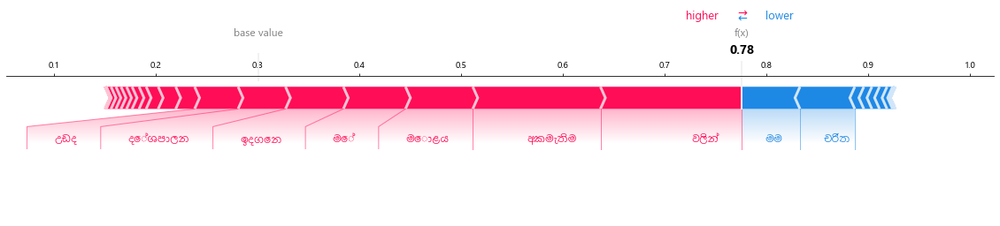

None

In [12]:
error_analysis(TC,gru_model,Y_pred)

##### LSTM

Build ML model
Model: "sequential_4"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
embedding_4 (Embedding)      (None, 100, 300)          6000000   
_________________________________________________________________
lstm (LSTM)                  (None, 128)               219648    
_________________________________________________________________
dropout_8 (Dropout)          (None, 128)               0         
_________________________________________________________________
dense_8 (Dense)              (None, 64)                8256      
_________________________________________________________________
dropout_9 (Dropout)          (None, 64)                0         
_________________________________________________________________
dense_9 (Dense)              (None, 1)                 65        
Total params: 6,227,969
Trainable params: 6,227,969
Non-trainable params: 0
_____________________________

Unexpected error in ping thread.
Traceback (most recent call last):
  File "C:\Users\Kavishka\anaconda3\lib\site-packages\urllib3\connectionpool.py", line 672, in urlopen
    chunked=chunked,
  File "C:\Users\Kavishka\anaconda3\lib\site-packages\urllib3\connectionpool.py", line 421, in _make_request
    six.raise_from(e, None)
  File "<string>", line 3, in raise_from
  File "C:\Users\Kavishka\anaconda3\lib\site-packages\urllib3\connectionpool.py", line 416, in _make_request
    httplib_response = conn.getresponse()
  File "C:\Users\Kavishka\anaconda3\lib\http\client.py", line 1344, in getresponse
    response.begin()
  File "C:\Users\Kavishka\anaconda3\lib\http\client.py", line 306, in begin
    version, status, reason = self._read_status()
  File "C:\Users\Kavishka\anaconda3\lib\http\client.py", line 267, in _read_status
    line = str(self.fp.readline(_MAXLINE + 1), "iso-8859-1")
  File "C:\Users\Kavishka\anaconda3\lib\socket.py", line 589, in readinto
    return self._sock.recv_into


Epoch 00006: val_loss improved from 0.63931 to 0.63636, saving model to G:/Github/Sinhala-Hate-Speech-Detection/trained_models/checkpoints/LSTM rand emb lr-0.0001\model.h5
4073/4073 - 99s - loss: 6923107.4249 - acc: 0.6909 - val_loss: 0.6364 - val_acc: 0.6689
Epoch 7/50

Epoch 00007: val_loss improved from 0.63636 to 0.63369, saving model to G:/Github/Sinhala-Hate-Speech-Detection/trained_models/checkpoints/LSTM rand emb lr-0.0001\model.h5
4073/4073 - 71s - loss: 3538016.8370 - acc: 0.6909 - val_loss: 0.6337 - val_acc: 0.6689
Epoch 8/50

Epoch 00008: val_loss improved from 0.63369 to 0.63097, saving model to G:/Github/Sinhala-Hate-Speech-Detection/trained_models/checkpoints/LSTM rand emb lr-0.0001\model.h5
4073/4073 - 67s - loss: 377363.4049 - acc: 0.6911 - val_loss: 0.6310 - val_acc: 0.6689
Epoch 9/50

Epoch 00009: val_loss improved from 0.63097 to 0.62889, saving model to G:/Github/Sinhala-Hate-Speech-Detection/trained_models/checkpoints/LSTM rand emb lr-0.0001\model.h5
4073/4073 - 

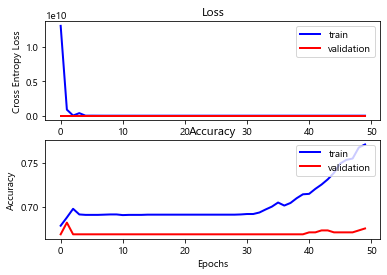

========= Eperiment -  LSTM rand emb lr-0.0001  =========
https://app.neptune.ai/codekcg23/Research-Experiments/e/RES-490
              precision    recall  f1-score   support

           0       0.70      1.00      0.82      1336
           1       0.92      0.04      0.08       604

    accuracy                           0.70      1940
   macro avg       0.81      0.52      0.45      1940
weighted avg       0.77      0.70      0.59      1940

Predicted     0   1
Actual             
0          1334   2
1           580  24


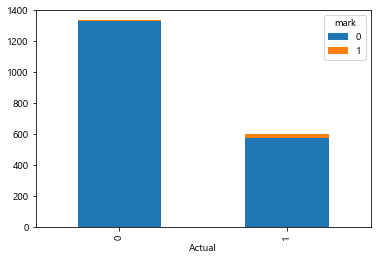

එන්න එන්න දැන් පරක්කු නෑ මුළ ටික හෙට එකෙන් අහමු ඊට පස්සේ ආයම
Predicted Label :  Not Hate  | Turth Label :  Not Hate

ඕකගේ ලාච්චුවේ දාපල්ලා නරුමයා
Predicted Label :  Not Hate  | Turth Label :  Hate

කන්න බොන්න දීලා කරට අත දාගෙන පිටිපස්සෙන් පිහියෙන් අනින සිස්ටම් එක තමයි පර්සි ලග තිබ්බෙ අන්තිමට පර්සි ලග හිටියා සුමනයා පර්සිටත් දුන්නෙ එවැනිම පාරක් තමයි හතර ගාතෙන් ඇදගෙන වැටෙන්න
Predicted Label :  Not Hate  | Turth Label :  Not Hate

කෝටි න් ගියත් ත්‍රී වීල් එකෙන් ගියත් යන්නෙ එකම පාරෙ නෙ බං කවදාහරි දවසක ඕකත් දිරලා වල පල්ලට යනවා කෝටි කින් කරන්න තව වැඩ කොච්චර නම් තියේද
Predicted Label :  Not Hate  | Turth Label :  Hate

ඒකි හිතන් ඇත්තේ අපිට පුපේ ඉත්තෑවෝ දුවනව කියලද දන්නෑ ෆේක් වලින් හරි ගිහින් එව්ව බලන්න
Predicted Label :  Not Hate  | Turth Label :  Hate

මේ තට්ටයව මුණ ගැහිලම විස්තරේ අහගනින් සියනෑවේ සිංහයා කියලා ඡන්දෙට ඉල්ලුවෙ සිංහයෙක් තියා හිවලෙක්වත් වෙන්න බෑ කියලා දැන් ඔප්පු වෙලා තියෙන්නෙ
Predicted Label :  Not Hate  | Turth Label :  Hate

සිවුරක් දමාගැනීම දමිත් අසංක පුක පෙන්වීම පිදුරංගල වීරයෝ

Unexpected error in ping thread.
Traceback (most recent call last):
  File "C:\Users\Kavishka\anaconda3\lib\site-packages\urllib3\connectionpool.py", line 672, in urlopen
    chunked=chunked,
  File "C:\Users\Kavishka\anaconda3\lib\site-packages\urllib3\connectionpool.py", line 421, in _make_request
    six.raise_from(e, None)
  File "<string>", line 3, in raise_from
  File "C:\Users\Kavishka\anaconda3\lib\site-packages\urllib3\connectionpool.py", line 416, in _make_request
    httplib_response = conn.getresponse()
  File "C:\Users\Kavishka\anaconda3\lib\http\client.py", line 1344, in getresponse
    response.begin()
  File "C:\Users\Kavishka\anaconda3\lib\http\client.py", line 306, in begin
    version, status, reason = self._read_status()
  File "C:\Users\Kavishka\anaconda3\lib\http\client.py", line 267, in _read_status
    line = str(self.fp.readline(_MAXLINE + 1), "iso-8859-1")
  File "C:\Users\Kavishka\anaconda3\lib\socket.py", line 589, in readinto
    return self._sock.recv_into

In [13]:
TC.EPOCHS =50
TC.BATCH_SIZE =16
TC.lr = 0.0001
TC.trainable = True
TC.tag = "LSTM rand emb lr-0.0001"

lstm_model = TC.get_model("LSTM")
lstm_model, hist = TC.train_model(lstm_model)
Y_pred = TC.model_evaluate(lstm_model,hist)
TC.save_predictions(Y_pred,TC.tag)

In [ ]:
error_analysis(TC,lstm_model,Y_pred)

##### Bidirectional GRU

Build ML model
bigru
Instructions for updating:
Call initializer instance with the dtype argument instead of passing it to the constructor
Instructions for updating:
Call initializer instance with the dtype argument instead of passing it to the constructor
Instructions for updating:
Call initializer instance with the dtype argument instead of passing it to the constructor
Model: "sequential_9"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
embedding_9 (Embedding)      (None, 100, 300)          6000000   
_________________________________________________________________
bidirectional (Bidirectional (None, 256)               329472    
_________________________________________________________________
dropout_18 (Dropout)         (None, 256)               0         
_________________________________________________________________
dense_18 (Dense)             (None, 64)                16448     
_________

Unexpected error in ping thread.
Traceback (most recent call last):
  File "C:\Users\Kavishka\anaconda3\lib\site-packages\urllib3\connectionpool.py", line 672, in urlopen
    chunked=chunked,
  File "C:\Users\Kavishka\anaconda3\lib\site-packages\urllib3\connectionpool.py", line 421, in _make_request
    six.raise_from(e, None)
  File "<string>", line 3, in raise_from
  File "C:\Users\Kavishka\anaconda3\lib\site-packages\urllib3\connectionpool.py", line 416, in _make_request
    httplib_response = conn.getresponse()
  File "C:\Users\Kavishka\anaconda3\lib\http\client.py", line 1344, in getresponse
    response.begin()
  File "C:\Users\Kavishka\anaconda3\lib\http\client.py", line 306, in begin
    version, status, reason = self._read_status()
  File "C:\Users\Kavishka\anaconda3\lib\http\client.py", line 267, in _read_status
    line = str(self.fp.readline(_MAXLINE + 1), "iso-8859-1")
  File "C:\Users\Kavishka\anaconda3\lib\socket.py", line 589, in readinto
    return self._sock.recv_into


Epoch 00005: val_loss did not improve from 0.49176
4073/4073 - 138s - loss: 0.1845 - acc: 0.9416 - val_loss: 0.5100 - val_acc: 0.7660
Epoch 6/50

Epoch 00006: val_loss did not improve from 0.49176
4073/4073 - 159s - loss: 0.1229 - acc: 0.9642 - val_loss: 0.5408 - val_acc: 0.7682
Epoch 7/50

Epoch 00007: val_loss did not improve from 0.49176
4073/4073 - 140s - loss: 0.0793 - acc: 0.9786 - val_loss: 0.5817 - val_acc: 0.7660
Epoch 8/50

Epoch 00008: val_loss did not improve from 0.49176
4073/4073 - 136s - loss: 9.7442 - acc: 0.9794 - val_loss: 0.5892 - val_acc: 0.7594
Epoch 9/50


Unexpected error in ping thread.
Traceback (most recent call last):
  File "C:\Users\Kavishka\anaconda3\lib\site-packages\urllib3\connectionpool.py", line 672, in urlopen
    chunked=chunked,
  File "C:\Users\Kavishka\anaconda3\lib\site-packages\urllib3\connectionpool.py", line 421, in _make_request
    six.raise_from(e, None)
  File "<string>", line 3, in raise_from
  File "C:\Users\Kavishka\anaconda3\lib\site-packages\urllib3\connectionpool.py", line 416, in _make_request
    httplib_response = conn.getresponse()
  File "C:\Users\Kavishka\anaconda3\lib\http\client.py", line 1344, in getresponse
    response.begin()
  File "C:\Users\Kavishka\anaconda3\lib\http\client.py", line 306, in begin
    version, status, reason = self._read_status()
  File "C:\Users\Kavishka\anaconda3\lib\http\client.py", line 267, in _read_status
    line = str(self.fp.readline(_MAXLINE + 1), "iso-8859-1")
  File "C:\Users\Kavishka\anaconda3\lib\socket.py", line 589, in readinto
    return self._sock.recv_into

Restoring model weights from the end of the best epoch.

Epoch 00009: val_loss did not improve from 0.49176
4073/4073 - 153s - loss: 0.0714 - acc: 0.9816 - val_loss: 0.5900 - val_acc: 0.7638
Epoch 00009: early stopping
train loss -  0.20238290140442336  train acc-  0.9396818
test loss -  0.4675906698728345  test acc-  0.8051546
Train acc: 0.940, Test acc: 0.805


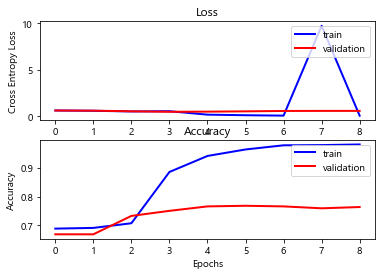

========= Eperiment -  BiGRU rand emb lr-0.0001  =========
https://app.neptune.ai/codekcg23/Research-Experiments/e/RES-491
              precision    recall  f1-score   support

           0       0.82      0.91      0.87      1336
           1       0.74      0.57      0.65       604

    accuracy                           0.81      1940
   macro avg       0.78      0.74      0.76      1940
weighted avg       0.80      0.81      0.80      1940

Predicted     0    1
Actual              
0          1218  118
1           260  344


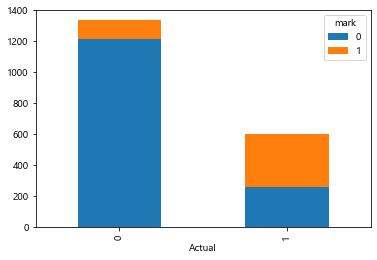

එන්න එන්න දැන් පරක්කු නෑ මුළ ටික හෙට එකෙන් අහමු ඊට පස්සේ ආයම
Predicted Label :  Not Hate  | Turth Label :  Not Hate

ඕකගේ ලාච්චුවේ දාපල්ලා නරුමයා
Predicted Label :  Not Hate  | Turth Label :  Hate

කන්න බොන්න දීලා කරට අත දාගෙන පිටිපස්සෙන් පිහියෙන් අනින සිස්ටම් එක තමයි පර්සි ලග තිබ්බෙ අන්තිමට පර්සි ලග හිටියා සුමනයා පර්සිටත් දුන්නෙ එවැනිම පාරක් තමයි හතර ගාතෙන් ඇදගෙන වැටෙන්න
Predicted Label :  Hate  | Turth Label :  Not Hate

කෝටි න් ගියත් ත්‍රී වීල් එකෙන් ගියත් යන්නෙ එකම පාරෙ නෙ බං කවදාහරි දවසක ඕකත් දිරලා වල පල්ලට යනවා කෝටි කින් කරන්න තව වැඩ කොච්චර නම් තියේද
Predicted Label :  Not Hate  | Turth Label :  Hate

ඒකි හිතන් ඇත්තේ අපිට පුපේ ඉත්තෑවෝ දුවනව කියලද දන්නෑ ෆේක් වලින් හරි ගිහින් එව්ව බලන්න
Predicted Label :  Hate  | Turth Label :  Hate

මේ තට්ටයව මුණ ගැහිලම විස්තරේ අහගනින් සියනෑවේ සිංහයා කියලා ඡන්දෙට ඉල්ලුවෙ සිංහයෙක් තියා හිවලෙක්වත් වෙන්න බෑ කියලා දැන් ඔප්පු වෙලා තියෙන්නෙ
Predicted Label :  Not Hate  | Turth Label :  Hate

සිවුරක් දමාගැනීම දමිත් අසංක පුක පෙන්වීම පිදුරංගල වීරයෝ සෙට් එක

In [24]:
TC.EPOCHS =50
TC.BATCH_SIZE =16
TC.lr = 0.0001
TC.trainable = True
TC.tag = "BiGRU rand emb lr-0.0001"

BiGRU_model = get_model(TC,"BiGRU")
BiGRU_model, hist = TC.train_model(BiGRU_model)
Y_pred = TC.model_evaluate(BiGRU_model,hist)
TC.save_predictions(Y_pred,TC.tag)

##### BiDirectional LSTM + CNN

Model: "sequential_17"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
embedding_16 (Embedding)     (None, 100, 300)          6000000   
_________________________________________________________________
spatial_dropout1d_1 (Spatial (None, 100, 300)          0         
_________________________________________________________________
bidirectional_7 (Bidirection (None, 100, 256)          439296    
_________________________________________________________________
bidirectional_8 (Bidirection (None, 100, 256)          394240    
_________________________________________________________________
conv1d_1 (Conv1D)            (None, 97, 64)            65600     
_________________________________________________________________
global_max_pooling1d_1 (Glob (None, 64)                0         
_________________________________________________________________
dense_30 (Dense)             (None, 64)              

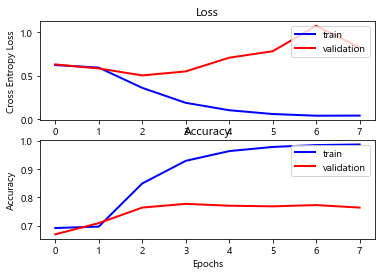

========= Eperiment -  BiLSTM CNN rand lr-0.0001  =========
https://app.neptune.ai/codekcg23/Research-Experiments/e/RES-493
              precision    recall  f1-score   support

           0       0.82      0.94      0.88      1336
           1       0.80      0.56      0.66       604

    accuracy                           0.82      1940
   macro avg       0.81      0.75      0.77      1940
weighted avg       0.82      0.82      0.81      1940

Predicted     0    1
Actual              
0          1254   82
1           268  336


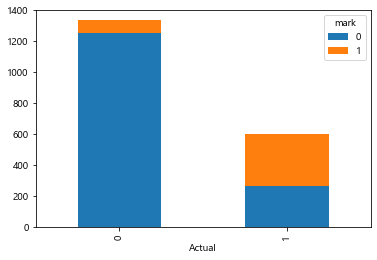

එන්න එන්න දැන් පරක්කු නෑ මුළ ටික හෙට එකෙන් අහමු ඊට පස්සේ ආයම
Predicted Label :  Not Hate  | Turth Label :  Not Hate

ඕකගේ ලාච්චුවේ දාපල්ලා නරුමයා
Predicted Label :  Not Hate  | Turth Label :  Hate

කන්න බොන්න දීලා කරට අත දාගෙන පිටිපස්සෙන් පිහියෙන් අනින සිස්ටම් එක තමයි පර්සි ලග තිබ්බෙ අන්තිමට පර්සි ලග හිටියා සුමනයා පර්සිටත් දුන්නෙ එවැනිම පාරක් තමයි හතර ගාතෙන් ඇදගෙන වැටෙන්න
Predicted Label :  Not Hate  | Turth Label :  Not Hate

කෝටි න් ගියත් ත්‍රී වීල් එකෙන් ගියත් යන්නෙ එකම පාරෙ නෙ බං කවදාහරි දවසක ඕකත් දිරලා වල පල්ලට යනවා කෝටි කින් කරන්න තව වැඩ කොච්චර නම් තියේද
Predicted Label :  Not Hate  | Turth Label :  Hate

ඒකි හිතන් ඇත්තේ අපිට පුපේ ඉත්තෑවෝ දුවනව කියලද දන්නෑ ෆේක් වලින් හරි ගිහින් එව්ව බලන්න
Predicted Label :  Hate  | Turth Label :  Hate

මේ තට්ටයව මුණ ගැහිලම විස්තරේ අහගනින් සියනෑවේ සිංහයා කියලා ඡන්දෙට ඉල්ලුවෙ සිංහයෙක් තියා හිවලෙක්වත් වෙන්න බෑ කියලා දැන් ඔප්පු වෙලා තියෙන්නෙ
Predicted Label :  Not Hate  | Turth Label :  Hate

සිවුරක් දමාගැනීම දමිත් අසංක පුක පෙන්වීම පිදුරංගල වීරයෝ සෙට

Unexpected error in ping thread.
Traceback (most recent call last):
  File "C:\Users\Kavishka\anaconda3\lib\site-packages\urllib3\connectionpool.py", line 672, in urlopen
    chunked=chunked,
  File "C:\Users\Kavishka\anaconda3\lib\site-packages\urllib3\connectionpool.py", line 421, in _make_request
    six.raise_from(e, None)
  File "<string>", line 3, in raise_from
  File "C:\Users\Kavishka\anaconda3\lib\site-packages\urllib3\connectionpool.py", line 416, in _make_request
    httplib_response = conn.getresponse()
  File "C:\Users\Kavishka\anaconda3\lib\http\client.py", line 1344, in getresponse
    response.begin()
  File "C:\Users\Kavishka\anaconda3\lib\http\client.py", line 306, in begin
    version, status, reason = self._read_status()
  File "C:\Users\Kavishka\anaconda3\lib\http\client.py", line 267, in _read_status
    line = str(self.fp.readline(_MAXLINE + 1), "iso-8859-1")
  File "C:\Users\Kavishka\anaconda3\lib\socket.py", line 589, in readinto
    return self._sock.recv_into

In [47]:
TC.EPOCHS =50
TC.BATCH_SIZE =16
TC.lr = 0.0001
TC.trainable = True
TC.tag = "BiLSTM CNN rand lr-0.0001"
bilstm_cnn_model = build_model2(TC)

bilstm_cnn_model, hist = TC.train_model(bilstm_cnn_model)
Y_pred = TC.model_evaluate(bilstm_cnn_model,hist)
TC.save_predictions(Y_pred,TC.tag)

##### BiGRU + CNN

Model: "sequential_16"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
embedding_15 (Embedding)     (None, 100, 300)          6000000   
_________________________________________________________________
spatial_dropout1d (SpatialDr (None, 100, 300)          0         
_________________________________________________________________
bidirectional_5 (Bidirection (None, 100, 256)          329472    
_________________________________________________________________
bidirectional_6 (Bidirection (None, 100, 256)          295680    
_________________________________________________________________
conv1d (Conv1D)              (None, 97, 64)            65600     
_________________________________________________________________
global_max_pooling1d (Global (None, 64)                0         
_________________________________________________________________
dense_28 (Dense)             (None, 64)              

Unexpected error in ping thread.
Traceback (most recent call last):
  File "C:\Users\Kavishka\anaconda3\lib\site-packages\urllib3\connectionpool.py", line 672, in urlopen
    chunked=chunked,
  File "C:\Users\Kavishka\anaconda3\lib\site-packages\urllib3\connectionpool.py", line 421, in _make_request
    six.raise_from(e, None)
  File "<string>", line 3, in raise_from
  File "C:\Users\Kavishka\anaconda3\lib\site-packages\urllib3\connectionpool.py", line 416, in _make_request
    httplib_response = conn.getresponse()
  File "C:\Users\Kavishka\anaconda3\lib\http\client.py", line 1344, in getresponse
    response.begin()
  File "C:\Users\Kavishka\anaconda3\lib\http\client.py", line 306, in begin
    version, status, reason = self._read_status()
  File "C:\Users\Kavishka\anaconda3\lib\http\client.py", line 267, in _read_status
    line = str(self.fp.readline(_MAXLINE + 1), "iso-8859-1")
  File "C:\Users\Kavishka\anaconda3\lib\socket.py", line 589, in readinto
    return self._sock.recv_into


Epoch 00004: val_loss did not improve from 0.50669
4073/4073 - 389s - loss: 0.1572 - acc: 0.9428 - val_loss: 0.5566 - val_acc: 0.7837
Epoch 5/50

Epoch 00005: val_loss did not improve from 0.50669
4073/4073 - 360s - loss: 0.0856 - acc: 0.9703 - val_loss: 0.6449 - val_acc: 0.7837
Epoch 6/50

Epoch 00006: val_loss did not improve from 0.50669
4073/4073 - 338s - loss: 0.0590 - acc: 0.9789 - val_loss: 0.7374 - val_acc: 0.7748
Epoch 7/50
Restoring model weights from the end of the best epoch.

Epoch 00007: val_loss did not improve from 0.50669
4073/4073 - 369s - loss: 0.0347 - acc: 0.9880 - val_loss: 0.8503 - val_acc: 0.7770
Epoch 00007: early stopping
train loss -  0.302522445167528  train acc-  0.88555014
test loss -  0.45715659666307196  test acc-  0.80360824
Train acc: 0.886, Test acc: 0.804


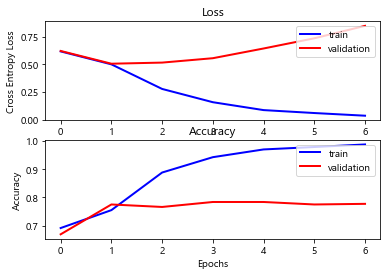

========= Eperiment -  BiGRU CNN rand lr-0.0001  =========
https://app.neptune.ai/codekcg23/Research-Experiments/e/RES-492
              precision    recall  f1-score   support

           0       0.81      0.93      0.87      1336
           1       0.77      0.52      0.62       604

    accuracy                           0.80      1940
   macro avg       0.79      0.73      0.75      1940
weighted avg       0.80      0.80      0.79      1940

Predicted     0    1
Actual              
0          1244   92
1           289  315


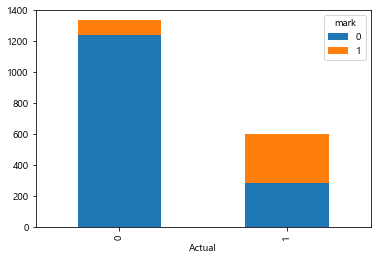

එන්න එන්න දැන් පරක්කු නෑ මුළ ටික හෙට එකෙන් අහමු ඊට පස්සේ ආයම
Predicted Label :  Not Hate  | Turth Label :  Not Hate

ඕකගේ ලාච්චුවේ දාපල්ලා නරුමයා
Predicted Label :  Not Hate  | Turth Label :  Hate

කන්න බොන්න දීලා කරට අත දාගෙන පිටිපස්සෙන් පිහියෙන් අනින සිස්ටම් එක තමයි පර්සි ලග තිබ්බෙ අන්තිමට පර්සි ලග හිටියා සුමනයා පර්සිටත් දුන්නෙ එවැනිම පාරක් තමයි හතර ගාතෙන් ඇදගෙන වැටෙන්න
Predicted Label :  Not Hate  | Turth Label :  Not Hate

කෝටි න් ගියත් ත්‍රී වීල් එකෙන් ගියත් යන්නෙ එකම පාරෙ නෙ බං කවදාහරි දවසක ඕකත් දිරලා වල පල්ලට යනවා කෝටි කින් කරන්න තව වැඩ කොච්චර නම් තියේද
Predicted Label :  Not Hate  | Turth Label :  Hate

ඒකි හිතන් ඇත්තේ අපිට පුපේ ඉත්තෑවෝ දුවනව කියලද දන්නෑ ෆේක් වලින් හරි ගිහින් එව්ව බලන්න
Predicted Label :  Hate  | Turth Label :  Hate

මේ තට්ටයව මුණ ගැහිලම විස්තරේ අහගනින් සියනෑවේ සිංහයා කියලා ඡන්දෙට ඉල්ලුවෙ සිංහයෙක් තියා හිවලෙක්වත් වෙන්න බෑ කියලා දැන් ඔප්පු වෙලා තියෙන්නෙ
Predicted Label :  Hate  | Turth Label :  Hate

සිවුරක් දමාගැනීම දමිත් අසංක පුක පෙන්වීම පිදුරංගල වීරයෝ සෙට් එක

In [45]:
TC.EPOCHS =50
TC.BATCH_SIZE =16
TC.lr = 0.0001
TC.tag = "BiGRU CNN rand lr-0.0001"
bigru_cnn_model = build_model(TC)

bigru_cnn_model, hist = TC.train_model(bigru_cnn_model)
Y_pred = TC.model_evaluate(bigru_cnn_model,hist)
TC.save_predictions(Y_pred,TC.tag)

In [ ]:
error_analysis(TC,bigru_cnn_model,Y_pred)